# Classification of Bird Species in Singapore

## Introduction
Singapore is a vibrant tropical country that, in spite of its urbanization, offers a paradise for nature lovers. In particular, its nature reserves are home to a host of different species of birds, attracting birdwatchers, nature enthusiasts and simple weekend hikers from all over the world. The official website of [Singapore's National Parks](https://www.nparks.gov.sg/biodiversity/wildlife-in-singapore/species-list/bird) catalogs over 400 different bird species that can be found on the island. Thus it happens frequently to take an image or see a bird flying in the wild without being able to recognize the species.

## Dataset
We construct our dataset by empploying webscrapers on websites such as [Flickr](./from_flickr_to_dataset.ipynb) and [Internet Bird Collection](./scraper_ibc.ipynb) to crawl publicly available images of the common bird species in Singapore.

In [144]:
import math
import pandas as pd
import numpy as np
import tensorflow as tf
from glob import glob
import os
import matplotlib.pyplot as plt
from IPython.display import display_html
import itertools
import keras_preprocessing.image
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.keras.preprocessing.image import load_img, img_to_array
from tensorflow.python.keras.applications import ResNet50
from tensorflow.python.keras.applications.resnet50 import preprocess_input
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, GlobalAveragePooling2D, BatchNormalization
# The following resolves the issue of possibly truncated images in the datasets
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
from sklearn.metrics import classification_report, confusion_matrix

## Data Preprocessing and Augmentation
Next we proceed with the preprocessing of the raw images.

This involves the following:

1. A [web application](http://172.21.144.45:5000/) is developed enabling users to manually remove noisy images from the raw dataset. Examples of noisy images are
 - Image does not correspond to the bird species
 - Too much sightline occlusion
 - More than 1 bird present

2. Remove bird species with fewer than 50 images

3. Data normalization and augmentation.

For (2) and (3), we employ the Keras API. Dataframes are created for the training and test sets.

In [2]:
# List all data folders for the raw images
data_folders = [f for f in os.scandir('data') if f.is_dir()]
nspecies = len(data_folders)

train_ratio = 0.8

train_paths = []
train_labels = []

test_paths = []
test_labels = []

# Create dataframes that can be used directly by Keras ImageDataGenerator class
for i in range(nspecies):
    image_list = glob(data_folders[i].path + "/*.jpg")

    # Remove datasets with fewer than 50 images
    if len(image_list)<50:
        continue

    # Splitting the datasets to training and testing
    train_idx = math.floor(len(image_list)*train_ratio)
    for j in range(train_idx):
        train_paths.append(image_list[j][5:])
        train_labels.append(data_folders[i].name[:data_folders[i].name.find('_')])
    for j in range(train_idx,len(image_list)):
        test_paths.append(image_list[j][5:])
        test_labels.append(data_folders[i].name[:data_folders[i].name.find('_')])
train_set = pd.DataFrame({'paths':train_paths, 'family':train_labels})
test_set = pd.DataFrame({'paths':test_paths, 'family':test_labels})

In the following, we employ the Keras preprocessing framework to read in the training and testing datasets defined via the dataframes above. Keras also allows us to perform data augmentation efficiently.


**If the following error arises**, update your Keras package.

*ImageDataGenerator' object has no attribute 'flow_from_dataframe'*

**Also take note that we do not implement rescale=1./255 here to be consistent with ResNet50 preprocessing. Otherwise, there will be issues when evaluating the trained model on the test set.** This [link](https://github.com/keras-team/keras/issues/3477) discusses a similar issue.

In [3]:
# Patch the dataframe filenames interaction in Keras preprocessing
def patched_list_filenames(directory, white_list_formats, split,
                                       class_indices, follow_links, df=False):
    dirname = os.path.basename(directory)
    if split:
        num_files = len(list(
            _iter_valid_files(directory, white_list_formats, follow_links)))
        start, stop = int(split[0] * num_files), int(split[1] * num_files)
        valid_files = list(
            _iter_valid_files(
                directory, white_list_formats, follow_links))[start: stop]
    else:
        valid_files = _iter_valid_files(
            directory, white_list_formats, follow_links)
    if df:
        filenames = []
        for root, fname in valid_files:
            absolute_path = os.path.join(root, fname)
            relative_path = os.path.relpath(absolute_path, directory)
            filenames.append(relative_path)
        return filenames
    classes = []
    filenames = []
    for root, fname in valid_files:
        classes.append(class_indices[dirname])
        absolute_path = os.path.join(root, fname)
        relative_path = os.path.join(
            dirname, os.path.relpath(absolute_path, directory))
        filenames.append(relative_path)
    return classes, filenames

keras_preprocessing.image._list_valid_filenames_in_directory.__code__ = patched_list_filenames.__code__

# Some hyperparameters
image_size = 224
batch_size = 32

# Train set generation and augmentation using Keras preprocessing
train_generator = ImageDataGenerator(horizontal_flip=True,
                                     width_shift_range = 0.4,
                                     height_shift_range = 0.4,
                                     zoom_range=0.3,
                                     rotation_range=20,
                                    )
train_generator = train_generator.flow_from_dataframe(
    dataframe=train_set, 
    directory='./data',
    x_col='paths', 
    y_col='family', 
    has_ext=True,
    target_size=(image_size, image_size),
    batch_size=batch_size,
    class_mode='categorical')

# Test set generation using Keras preprocessing
test_generator = ImageDataGenerator()
test_generator = test_generator.flow_from_dataframe(
    dataframe=test_set, 
    directory="./data/", 
    x_col="paths", 
    y_col="family", 
    has_ext=True,
    target_size=(image_size, image_size),
    batch_size=batch_size,
    class_mode='categorical')

num_classes = len(train_generator.class_indices)

Found 16888 images belonging to 60 classes.
Found 4252 images belonging to 60 classes.


## Data Visualization and Exploration

In [98]:
# First we list the amount of training and testing images for each family
train_distribution = train_set.groupby('family', as_index=False).count()
train_distribution.columns=['family', '# Train Images']
# train_distribution = train_distribution.sort_values('# Train Images')

test_distribution = test_set.groupby('family', as_index=False).count()
test_distribution.columns=['family', '# Test Images']

# Display the training and testing images side by side
def display_side_by_side(*args):
    html_str=''
    for df in args:
        html_str+=df.to_html()
    display_html(html_str.replace('table','table style="display:inline"'),raw=True)

display_side_by_side(train_distribution, test_distribution)

,family,# Train Images
0,acridotheres,623
1,actitis,481
2,aegithina,127
3,aethopyga,85
4,alcedo,732
5,amaurornis,238
6,anthreptes,77
7,anthus,106
8,aplonis,73
9,ardea,1058


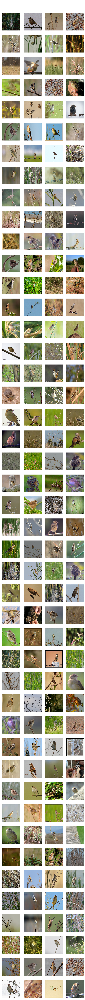

In [7]:
# Read in all images belonging to a family
def read_images(family):
    paths = train_set['paths'][train_set['family']==family].tolist()
    paths = ['./data/' + s for s in paths]
    imgs = [load_img(img_path, target_size=(image_size, image_size)) for img_path in paths]
    img_array = np.array([img_to_array(img) for img in imgs])
    return img_array/255.

# Visualize images from a family
families = dict((v,k) for k,v in train_generator.class_indices.items())

family = families[0]

imgs = read_images(family)
n_imgs = imgs.shape[0]
columns = 4
fig = plt.figure(figsize=(20,int(n_imgs/columns*5)))
for i in range(n_imgs):
    plt.subplot(n_imgs/columns+1, columns, i + 1)
    plt.imshow(imgs[i])
    plt.axis('off')
plt.suptitle(family.upper(), fontsize='x-large')
fig.tight_layout
fig.subplots_adjust(top=0.97)

## Our Proposed Classification Pipeline

Feature extraction will be done using the ResNet50 network pretrained on ImageNet.

Instead of classifying over the species directly, we adopt a two-step classification pipeline:

-  The first step classifies an input image into a family. This step utilises the softmax entropy loss.
-  Based on the output of the family classification, the second step is to further classify into the species. Here a metric learning loss will be used.

In [5]:
# Pretrained ResNet50 on ImageNet
model = Sequential()

model.add(ResNet50(include_top=False, pooling='avg', weights='imagenet'))
model.add(Flatten())
model.add(BatchNormalization())
model.add(Dense(2048, activation='relu'))
model.add(BatchNormalization())
model.add(Dense(1024, activation='relu'))
model.add(BatchNormalization())
model.add(Dense(num_classes, activation='softmax'))

model.layers[0].trainable = False

In [6]:
def top_3_accuracy(y_true, y_pred):
    return tf.keras.metrics.top_k_categorical_accuracy(y_true, y_pred, k=3)
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=[top_3_accuracy])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
hist = model.fit_generator(generator=train_generator,
                           steps_per_epoch=int(train_set.shape[0]/batch_size)+1,
                           epochs=10,
                           shuffle=True,
                           validation_data=test_generator,
                           validation_steps=int(test_set.shape[0]/batch_size)+1)

Epoch 1/10
528/528 [==============================] - 341s 646ms/step - loss: 2.3564 - acc: 0.4154 - val_loss: 2.4481 - val_acc: 0.4440
Epoch 2/10
528/528 [==============================] - 322s 609ms/step - loss: 1.7389 - acc: 0.5226 - val_loss: 2.3285 - val_acc: 0.4680
Epoch 3/10
528/528 [==============================] - 344s 652ms/step - loss: 1.5197 - acc: 0.5627 - val_loss: 2.1669 - val_acc: 0.5028
Epoch 4/10
528/528 [==============================] - 326s 618ms/step - loss: 1.4092 - acc: 0.5876 - val_loss: 2.0135 - val_acc: 0.5167
Epoch 5/10
528/528 [==============================] - 341s 646ms/step - loss: 1.3248 - acc: 0.6064 - val_loss: 2.2654 - val_acc: 0.5047
Epoch 6/10
528/528 [==============================] - 352s 668ms/step - loss: 1.2363 - acc: 0.6257 - val_loss: 2.3082 - val_acc: 0.4976
Epoch 7/10
528/528 [==============================] - 313s 593ms/step - loss: 1.1862 - acc: 0.6405 - val_loss: 1.9731 - val_acc: 0.5414
Epoch 8/10
528/528 [============================

## Evaluating on Test Images

We evaluate on test images and display the results using a confusion matrix and precision/recall/f1-scores.

In [131]:
def read_test_images(family):
    paths = test_set['paths'][test_set['family']==family].tolist()
    paths = ['./data/' + s for s in paths]
    imgs = [load_img(img_path, target_size=(image_size, image_size)) for img_path in paths]
    img_array = np.array([img_to_array(img) for img in imgs])
    return preprocess_input(img_array)

prediction_results = []
ground_truth = []
test_distribution.to_dict()
for i in range(len(families)):
    prediction_results.append(model.predict_classes(read_test_images(families[i])))
    n_test_imgs = test_distribution.loc[test_distribution['family']==families[i]].iloc[0][1]
    ground_truth.append(np.ones(n_test_imgs)*i)
prediction_results = np.hstack(prediction_results)
ground_truth = np.hstack(ground_truth)

In [139]:
print('Confusion Matrix')
CM = confusion_matrix(ground_truth, prediction_results)
print(CM)
target_names = [families[i] for i in range(len(families))]
print('Classification Report')
CR = classification_report(ground_truth, prediction_results, target_names=target_names)
print(CR)

Confusion Matrix
[[26  0  0 ...  0  0 10]
 [ 0  9  1 ...  0  0  0]
 [ 0  2  8 ...  0  0  0]
 ...
 [ 0  0  0 ...  5  0  0]
 [ 2  0  0 ...  0 14  0]
 [ 0  0  0 ...  0  0 19]]
Classification Report
              precision    recall  f1-score   support

   cisticola       0.32      0.57      0.41        46
  chlidonias       0.41      0.28      0.33        32
    sternula       0.18      0.27      0.22        30
  amaurornis       0.71      0.48      0.57        60
  anthreptes       0.18      0.10      0.13        20
  pycnonotus       0.50      0.08      0.14        24
    bubulcus       0.74      0.17      0.28       219
     aplonis       0.57      0.21      0.31        19
 todiramphus       0.12      0.23      0.15        52
      tringa       0.54      0.78      0.64       267
     oriolus       0.00      0.00      0.00        39
  spilopelia       0.52      0.45      0.48        29
      pernis       0.64      0.24      0.35        29
     aviceda       0.00      0.00      0.00     

/home/matuser2/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
